20230619 = Apenas treinamento, crossover + semantica, 100k avaliações, 500 população, <uop> com tudo

standard

In [46]:
import os
import glob
import pandas as pd
import plot as plot
import matplotlib.pyplot as plt
import numpy as np
import scipy

import shutil

import warnings
warnings.filterwarnings("ignore")

dfs = []

# Set the root directory where you want to search for "res.csv"
root_directories = ['fs/results']  # Replace with your directory path

for root_directory in root_directories:
    # Use the glob module to find all files named "res.csv" recursively
    csv_files = glob.glob(os.path.join(root_directory, '**', 'res.csv'), recursive=True)

    # Print the paths of all found "res.csv" files
    for file in csv_files:
        # print(file)
        df = pd.read_csv(file, sep = ";", header=None)
        # print(df)
        df.columns = ["seed", "time", "training", "test", "validation", "model"]

        # fs/results/f11/500/original/SC1-GGP/res.csv
        
        df['constants']   = [file.split('/')[2] for i in range(len(df))]
        df['problem']   = [file.split('/')[2] for i in range(len(df))]
        df['amount']    = [file.split('/')[3] for i in range(len(df))]
        df['noise']     = [file.split('/')[4] for i in range(len(df))]
        df['distance']  = [file.split('/')[5] for i in range(len(df))]
        df['variation'] = [file.split('/')[6] for i in range(len(df))]
        df['lower']     = [file.split('/')[7] for i in range(len(df))]
        df['upper']     = [file.split('/')[8] for i in range(len(df))]
        df['seed_file'] = [str(seed) + '.hist' for seed in df.seed]
        
        # print(file)
        dfs.append(df)
            
results = pd.concat(dfs)
results.columns = ['seed' , 'time', 'training', 'test', 'validation', 'model', 'constants', 'problem', 'amount', 'noise', 'distance', 'variation', 'lower', 'upper', 'seed_file']
results["training"] = pd.to_numeric(results["training"])
results["test"] = pd.to_numeric(results["test"])
results["validation"] = pd.to_numeric(results["validation"])
results["lower"] = pd.to_numeric(results["lower"])
results["upper"] = pd.to_numeric(results["upper"])
results = results.reset_index(drop=True)
results

,seed,time,training,test,validation,model,constants,problem,amount,noise,distance,variation,lower,upper,seed_file
0,0,1118,221.878605,382.441083,1541.297331,f0() = (1541.297331) x1 ln ln x1 + exp 0.5 ...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,0.hist
1,1,701,143.250212,255.765698,252.404787,f0() = (252.4047872) x2 x2 / exp sin x1 x1 ...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,1.hist
2,2,1265,187.404489,312.368757,190.679846,f0() = (190.6798458) x2 tanh sin sqrt x2 x2...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,2.hist
3,0,1202,216.085834,352.231593,1620.263653,f0() = (1620.263653) x2 x2 / exp sin x2 sqr...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+02,0.hist
4,1,1401,190.154410,319.844976,193.641867,f0() = (193.641867) x2 x2 ln x1 + sin x2 ex...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+02,1.hist
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58747,1,685,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-07,1.hist
58748,2,643,8.218649,4.896113,9.316029,f0() = (9.316029491) x1 sqrt x2 sin + x1 x1...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-07,2.hist
58749,0,361,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-03,0.hist
58750,1,515,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-03,1.hist


In [47]:
results = results.drop_duplicates(subset=["problem", "amount", "noise", "distance", "variation", 'lower', 'upper', "seed"])
results

,seed,time,training,test,validation,model,constants,problem,amount,noise,distance,variation,lower,upper,seed_file
0,0,1118,221.878605,382.441083,1541.297331,f0() = (1541.297331) x1 ln ln x1 + exp 0.5 ...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,0.hist
1,1,701,143.250212,255.765698,252.404787,f0() = (252.4047872) x2 x2 / exp sin x1 x1 ...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,1.hist
2,2,1265,187.404489,312.368757,190.679846,f0() = (190.6798458) x2 tanh sin sqrt x2 x2...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+03,2.hist
3,0,1202,216.085834,352.231593,1620.263653,f0() = (1620.263653) x2 x2 / exp sin x2 sqr...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+02,0.hist
4,1,1401,190.154410,319.844976,193.641867,f0() = (193.641867) x2 x2 ln x1 + sin x2 ex...,f11,f11,100,noise,ABS,RSC,1.000000e-01,1.000000e+02,1.hist
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58747,1,685,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-07,1.hist
58748,2,643,8.218649,4.896113,9.316029,f0() = (9.316029491) x1 sqrt x2 sin + x1 x1...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-07,2.hist
58749,0,361,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-03,0.hist
58750,1,515,7.703220,4.429035,8.257393,f0() = (8.257393199) x2 exp x2 tanh - x1 sq...,f1,f1,50,original,COS,SSC,1.000000e-09,1.000000e-03,1.hist


In [48]:
print(results.problem.unique(), "=", len(results.problem.unique()))
print(results.variation.unique())  
print(results.distance.unique())   
print(results.lower.unique())   
print(results.upper.unique())

['f11' 'f8' 'f5' 'f9' 'f10' 'f2' 'f7' 'f6' 'f1'] = 9
['RSC' 'SAC' 'FVSC' 'SSC']
['ABS' 'COS']
[1.e-01 1.e-08 1.e-05 1.e+02 1.e-10 1.e+01 1.e-02 1.e+00 1.e-06 1.e-04
 1.e-07 1.e-03 1.e-09]
[1.e+03 1.e+02 1.e+01 1.e+00 1.e-01 1.e-05 1.e-02 1.e-06 1.e-04 1.e-07
 1.e-03 1.e-08 1.e-09]


In [49]:
fit_model = 'training'

In [50]:
grouped = results.groupby(
    ['problem', 'amount', 'noise', 'distance', 'variation', 'lower', 'upper'], 
    as_index=False
).agg(
    {fit_model: ['count', 'min', 'mean', 'median', 'max', 'std']}
)

grouped

problem amount     noise distance variation         lower         upper  \
                                                                                
0          f1    100     noise      ABS      FVSC  1.000000e-10  1.000000e-09   
1          f1    100     noise      ABS      FVSC  1.000000e-10  1.000000e-08   
2          f1    100     noise      ABS      FVSC  1.000000e-10  1.000000e-07   
3          f1    100     noise      ABS      FVSC  1.000000e-10  1.000000e-06   
4          f1    100     noise      ABS      FVSC  1.000000e-10  1.000000e-05   
...       ...    ...       ...      ...       ...           ...           ...   
19579      f9     50  original      COS       SSC  1.000000e-04  1.000000e-02   
19580      f9     50  original      COS       SSC  1.000000e-04  1.000000e-01   
19581      f9     50  original      COS       SSC  1.000000e-03  1.000000e-02   
19582      f9     50  original      COS       SSC  1.000000e-03  1.000000e-01   
19583      f9     50  original      COS       SSC  1.000000e-02  1.000000e-01   

      training                                                          \
         count          min           mean       median            max   
0            3     6.246808   6.284059e+00     6.246808   6.358560e+00   
1            3     6.246808   6.284059e+00     6.246808   6.358560e+00   
2            3     6.246808   6.284059e+00     6.246808   6.358560e+00   
3            3     6.246808   6.284059e+00     6.246808   6.358560e+00   
4            3     6.246808   6.284059e+00     6.246808   6.358560e+00   
...        ...          ...            ...          ...            ...   
19579        3  1362.670110  8.635197e+123  1362.670110  2.590559e+124   
19580        3   946.165807   1.223835e+03  1362.670110   1.362670e+03   
19581        3  1362.670110  8.635197e+123  1362.670110  2.590559e+124   
19582        3   946.165807   1.223835e+03  1362.670110   1.362670e+03   
19583        3  1362.670110  8.635197e+123  1362.670110  2.590559e+124   

                      
                 std  
0       6.452023e-02  
1       6.452023e-02  
2       6.452023e-02  
3       6.452023e-02  
4       6.452023e-02  
...              ...  
19579  1.495660e+124  
19580   2.404689e+02  
19581  1.495660e+124  
19582   2.404689e+02  
19583  1.495660e+124  

[19584 rows x 13 columns]

In [51]:
# grouped = grouped[grouped.variation != "DEF"]
# grouped = grouped[grouped.problem == "f1"]

In [52]:
grouped['minimum'] = grouped[fit_model]['median']

# Gerar os PP

### Variações para Crossover

# Kruskal Wallis

In [53]:
# ks = []

# for parametro in melhores_parametros:
#     ks.append(results[(results.problem == 'f1') & (results.variation == parametro['variation']) & (results.lower == parametro['lower']) & (results.upper == parametro['upper'])])
    
# ks = pd.concat(ks)
# ks

In [54]:
# kws = {}
# kwp = {}

# for i, va in enumerate(ks.variation.unique()):
#     kws[va] = {}
#     kwp[va] = {}

#     for j, vb in enumerate(ks.variation.unique()[:]):
#         ra, rb = ks[ks.variation == va][fit_model].values, ks[ks.variation == vb][fit_model].values

#         try:
#             kws[va][vb], kwp[va][vb] = scipy.stats.kruskal(ra, rb)
#         except:
#             kws[va][vb], kwp[va][vb] = None, None

# kws = pd.DataFrame(kws).T.round(2)
# kwp = pd.DataFrame(kwp).T.round(2)

In [55]:
# kws

In [56]:
# kwp

contagem de quantas vezes ele tem o melhor resultado (mediana) ou é similiar ao que deu melhor resultado

In [57]:
grouped = grouped.sort_values(by="problem")

In [59]:
pp_dfs = {}

for distance in grouped.distance.unique():
    # print(distance)
    pp_dfs[distance] = {}
    for noise in grouped.noise.unique():
        # print(distance, noise)
        pp_dfs[distance][noise] = {}
        for amount in grouped.amount.unique():
            # print(distance, noise, amount)
            pp_dfs[distance][noise][amount] = {}
            for variation in grouped.variation.unique():
                # print(distance, noise, amount, variation)
                pp_dfs[distance][noise][amount][variation] = {}
                for lower in grouped.lower.unique():
                    for upper in grouped.upper.unique():
                        if lower < upper:
                            # print(distance, noise, amount, variation, lower, upper)
                            #seleciona os resultados para um
                            vet = grouped[
                                (grouped.distance == distance) &
                                (grouped.noise == noise) &
                                (grouped.amount == amount) &
                                (grouped.variation == variation) &
                                (grouped.lower == lower) & 
                                (grouped.upper == upper)
                            ].sort_values(by=("training", "median"))
                            
                            vet.index = (vet.problem.values)
                            
                            if len(vet):
                                pp_dfs[distance][noise][amount][variation][f"{lower} - {upper}"] = vet[("training", "median")]
                pp_dfs[distance][noise][amount][variation] = pd.DataFrame(pp_dfs[distance][noise][amount][variation])
                pp_dfs[distance][noise][amount][variation] = pp_dfs[distance][noise][amount][variation].div(pp_dfs[distance][noise][amount][variation].min(axis=1), axis=0)

In [ ]:
distance, noise, amount, variation

('COS', 'original', '50', 'SSC')

In [ ]:
# pp_dfs[distance][noise][amount]["SCPS"]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


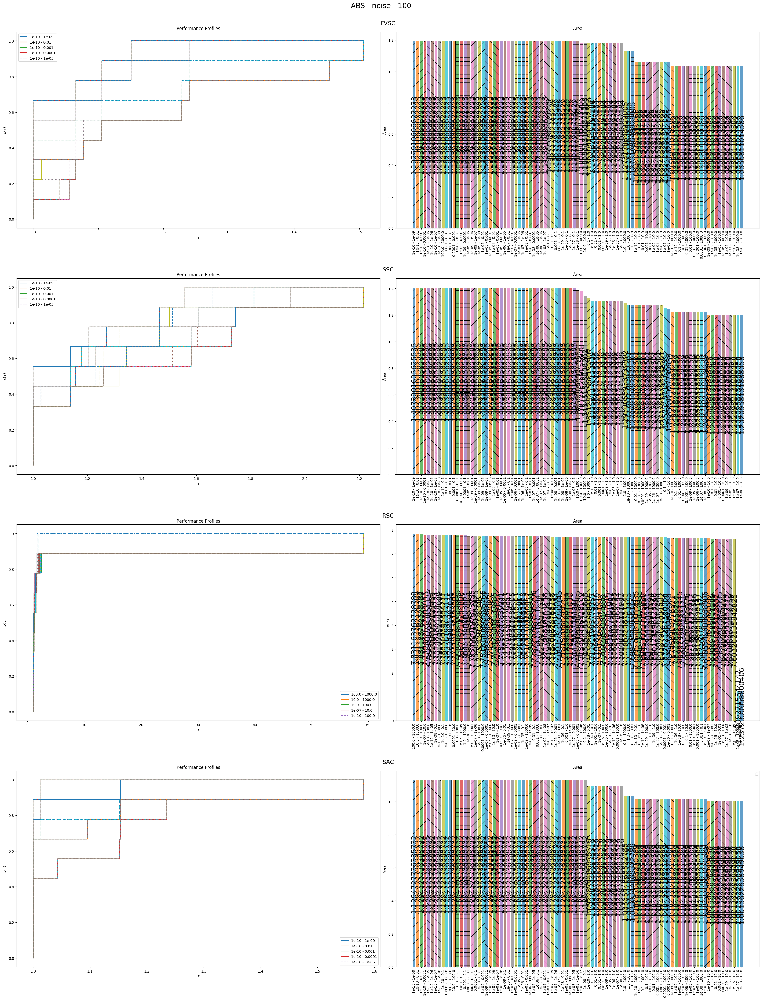

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


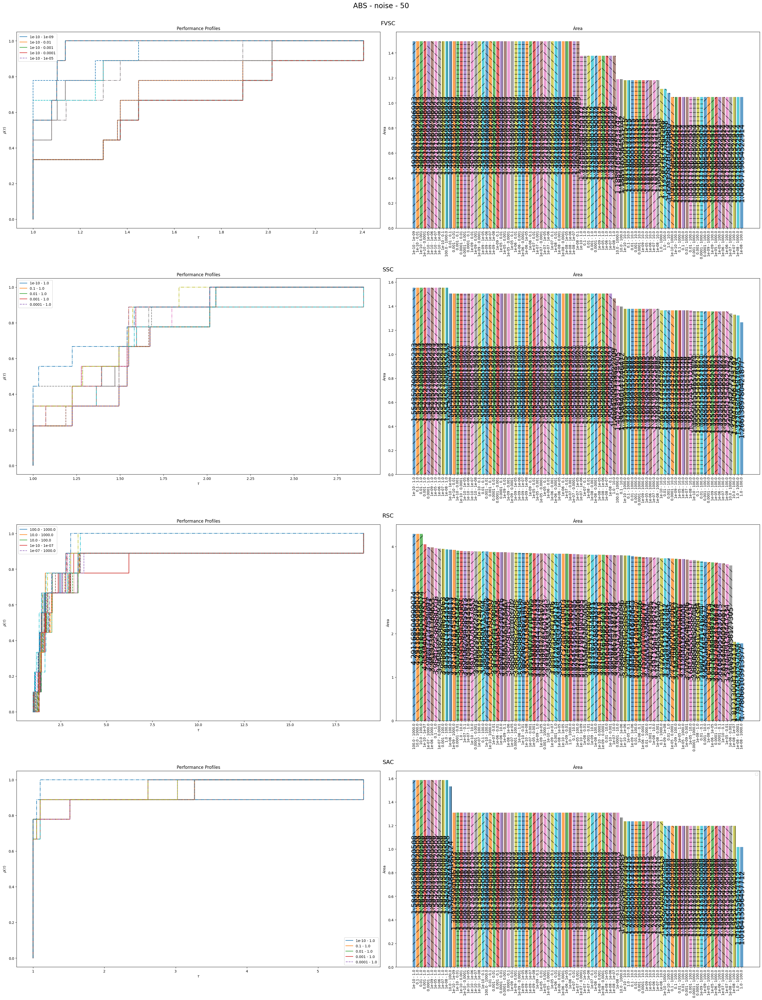

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


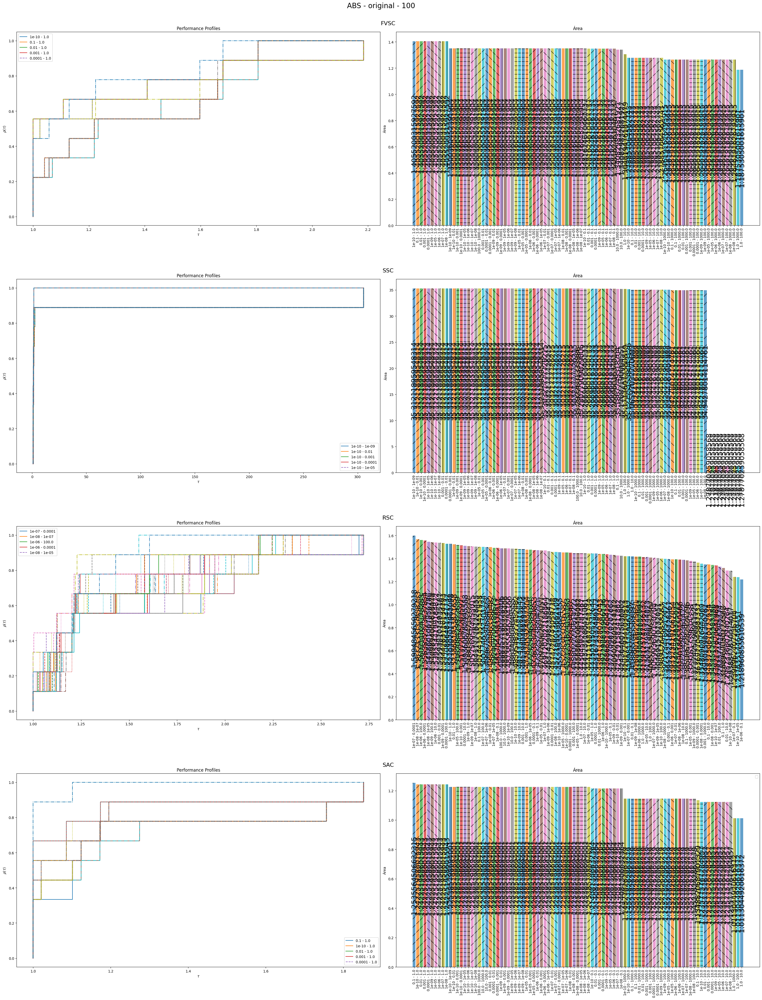

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


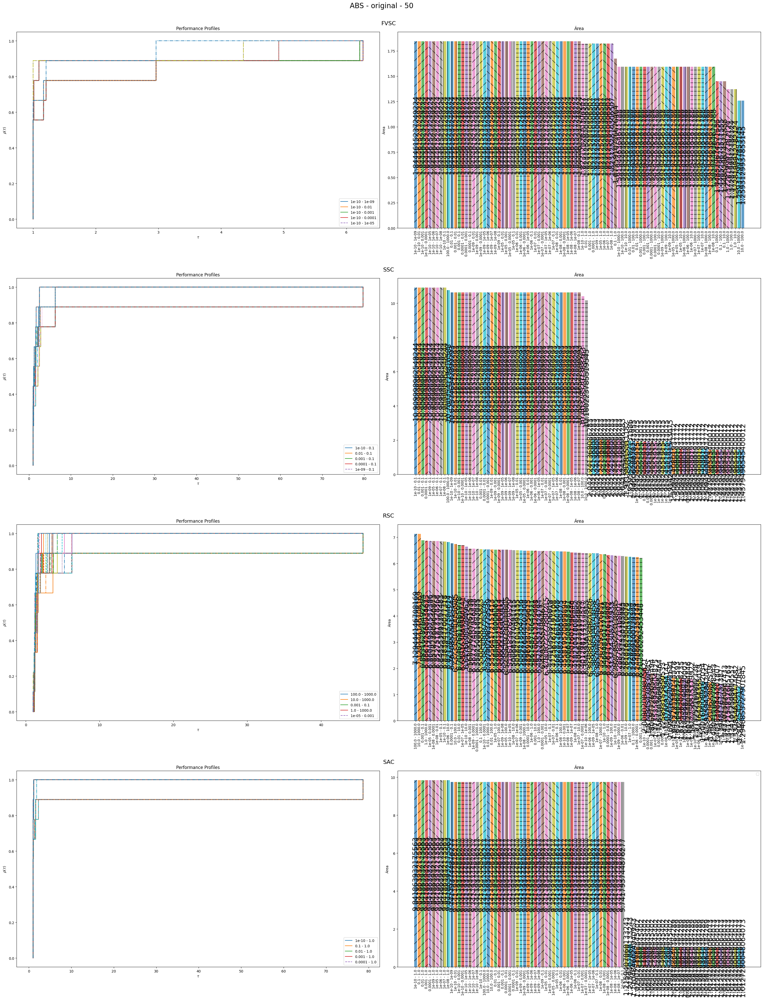

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


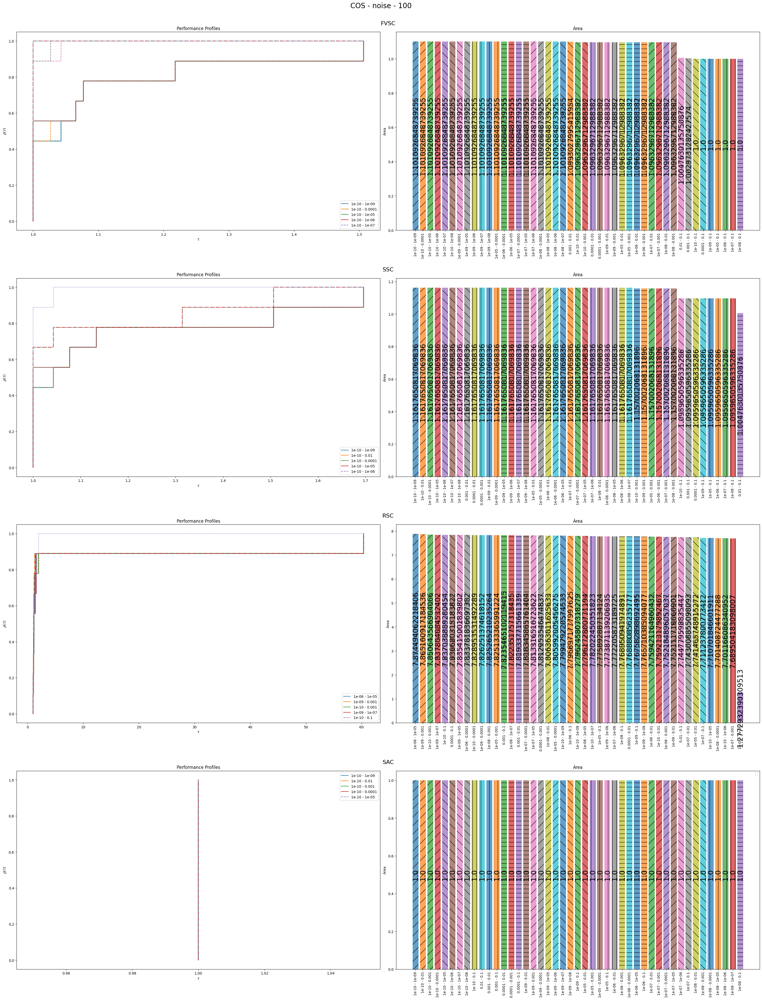

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


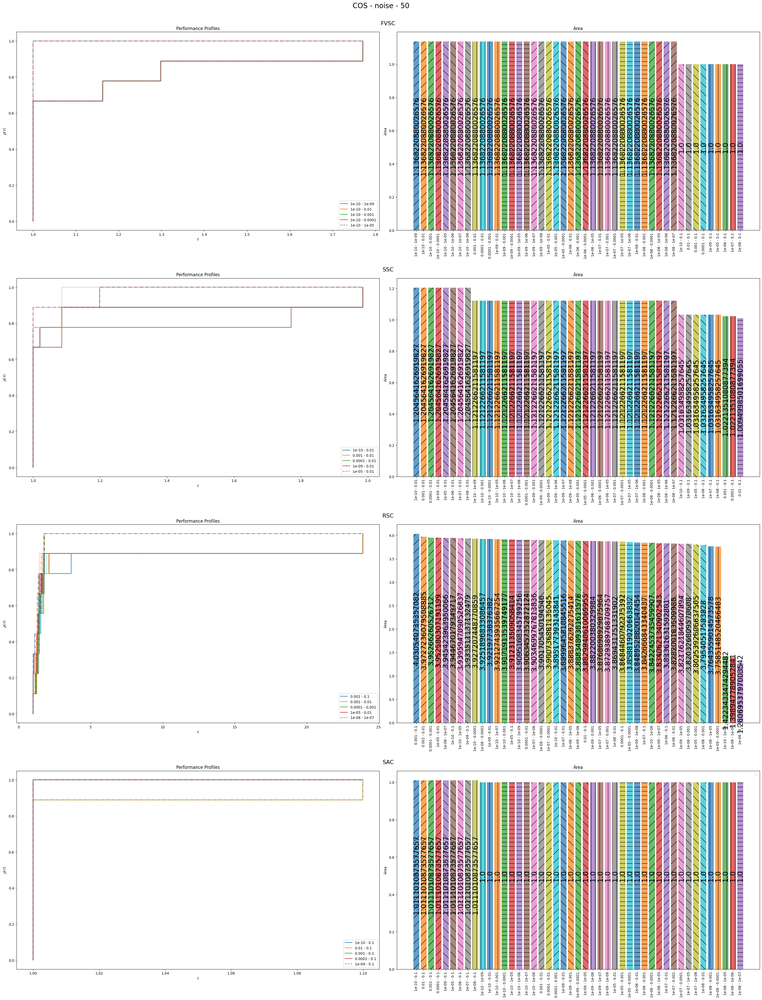

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


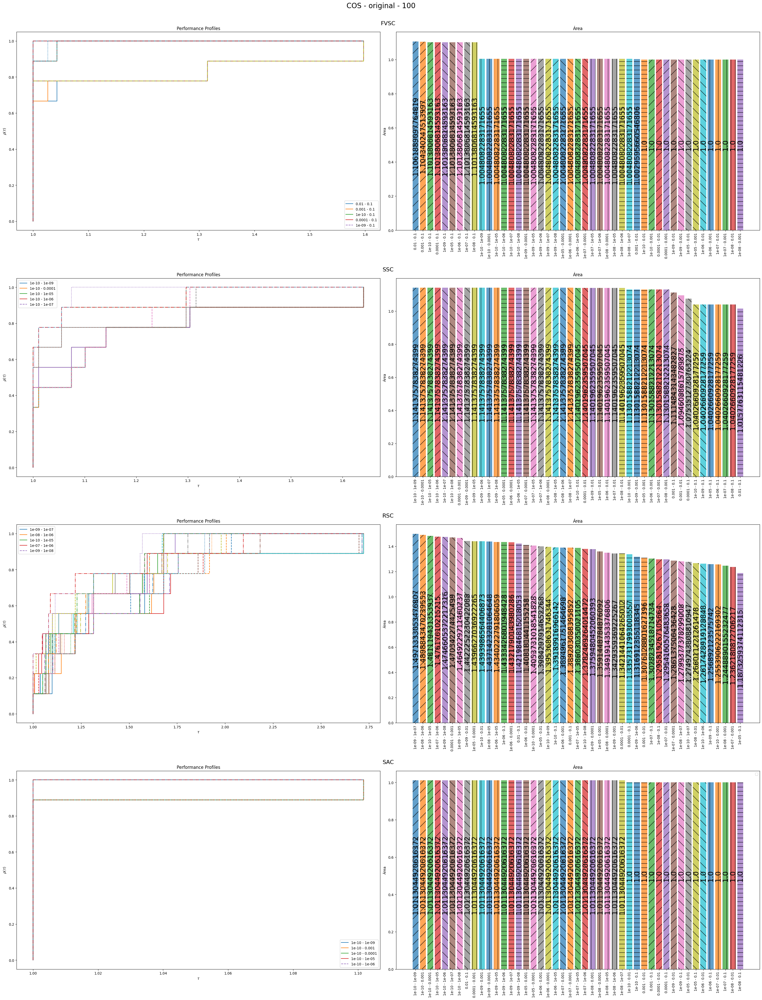

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


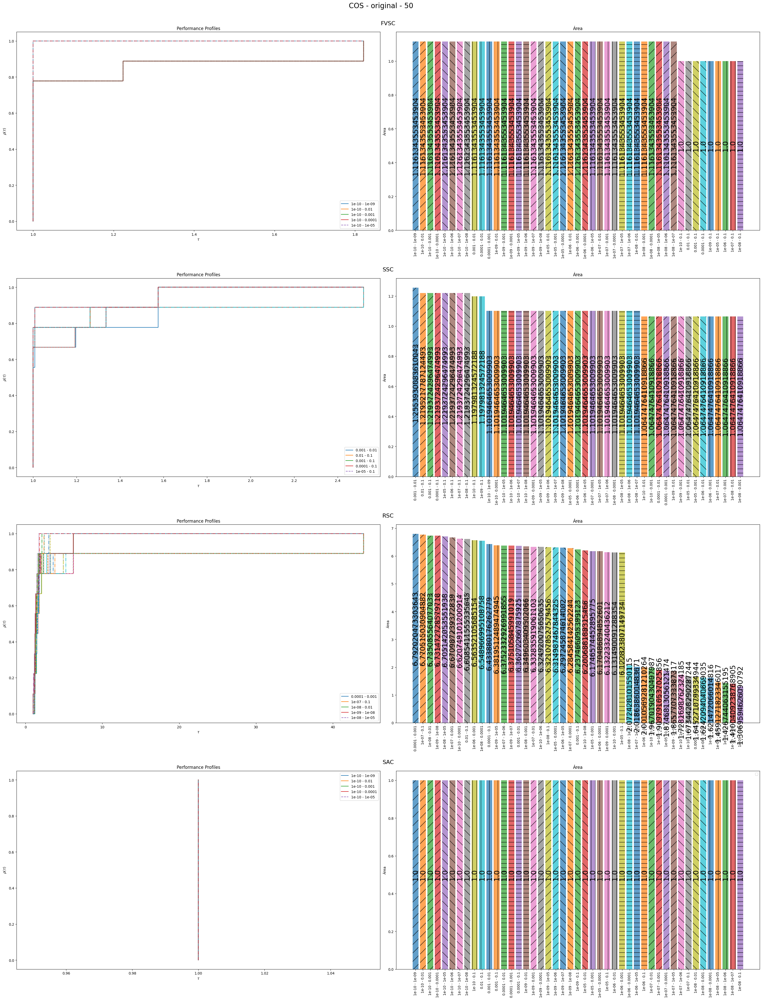

In [60]:
for distance in grouped.distance.unique():
    for noise in grouped.noise.unique():
        for amount in grouped.amount.unique():
            fig, ax = plt.subplots(len(grouped.variation.unique()), 2, figsize=(30, 40))
            
            for v, variation in enumerate(grouped.variation.unique()):
                ax1, ax2 = ax[v][0], ax[v][1]
                resume = pp_dfs[distance][noise][amount][variation]
                # Gráficos

                vet = []
                names = resume.columns

                for key in names:      
                    resume_ = np.array(resume[key])
                    resume_ = np.sort(resume_)
                    
                    h = 1. / len(resume)
                    linha = [[1, 0]]

                    for i in resume_:
                        linha.append([i, linha[-1][1]])
                        linha.append([i, linha[-1][1] + h])

                    linha = np.array(linha).T
                    # print(linha)
                    vet.append(linha[0,:])
                vet = np.array(vet).T
                maior = np.max(vet)
                maior = [[maior for _ in range(len(names))]]
                vet = np.concatenate([vet, np.array(maior)])
                
                vet = pd.DataFrame(vet)

                vet.columns = names
                vet['h'] = [h*(i//2) for i in range(len(vet))]
                
                # Lista de cores
                colors_styles = plt.cm.tab10([i % 10 for i in range(len(names))])

                # Lista de estilos de linha
                line_styles = ['-', '--', '-.', ':']
                
                # Padrões
                patterns = ['/', '\\', '|', '-', '+', 'x', 'o', 'O', '.', '*']
                
                colors = []
                for l in range(len(line_styles)):
                    for color in colors_styles:
                        colors.append([color, line_styles[l], patterns[l]])
                        
                # Adicionar um eixo invisível para o título da linha
                ax3 = fig.add_subplot(len(grouped.variation.unique()), 1, v + 1, frame_on=False)
                ax3.axis('off')  # Esconder o eixo
                ax3.set_title(variation, fontsize=16, pad=20)
                
                # Calcula as áreas
                areas = {}
                for i in range(len(names)):
                    areas[names[i]] = np.trapz(vet['h'], vet[names[i]])
                areas = dict(sorted(areas.items(), key=lambda item: item[1], reverse=True))
                names = list(areas.keys())[:]

                # Gráfico de barras à direita
                for i in range(len(names)):
                    ax2.bar(names[i], areas[names[i]], color=colors[i][0], hatch=patterns[(i // len(line_styles)) % len(line_styles)], alpha=0.7)
                    # Adicionando o valor dentro da barra
                    height = areas[names[i]]
                    ax2.text(
                        names[i],  # Posição x do texto (nome da barra)
                        height / 2,  # Posição y do texto (metade da altura da barra)
                        '{}'.format(height),  # Texto (valor da barra)
                        ha='center',  # Alinhamento horizontal do texto
                        va='center',  # Alinhamento vertical do texto
                        color='black',  # Cor do texto
                        fontsize=20,  # Tamanho da fonte
                        rotation=90
                    )
                ax2.set_title('Área')
                ax2.set_ylabel('Área')
                # Configurar labels na vertical
                ax2.set_xticks(range(len(names)))
                ax2.set_xticklabels([names[i] for i in range(len(names))], fontsize=10, rotation=90)
                plt.xticks(rotation=90)

                # Gráfico de linhas à esquerda
                for i in range(len(names)):
                    ax1.plot(vet[names[i]], vet['h'], color=colors[i][0], linestyle=line_styles[(i // len(line_styles)) % len(line_styles)], label = names[i] if i < 5 else None)
                    
                ax1.set_title("Performance Profiles")                                      
                ax1.set_xlabel(fr'$\tau$')
                ax1.set_ylabel(fr'$\rho(\tau)$')
                ax1.legend()

            plt.legend()
            plt.suptitle(f"{distance} - {noise} - {amount}", fontsize=20)
            plt.tight_layout(pad=0.8, rect=[0, 0, 1, 0.98])
            plt.show()
            # plt.savefig(f"pp/{distance} - {noise} - {amount} - {variation}.png")
            plt.close()